In [1]:
import math
import numpy as np

from PIL import Image
from PIL import ImageFilter

# Image Preprocessing

There is one main package that every Python user should be aware of when doing image preprocessing, that is Python Image Library or PIL which goes by the name [Pillow](https://pillow.readthedocs.io/en/stable/handbook/tutorial.html). Of course, there are packages like OpenCV but that is really meant for doing computer vision tasks once you have the images ready. 

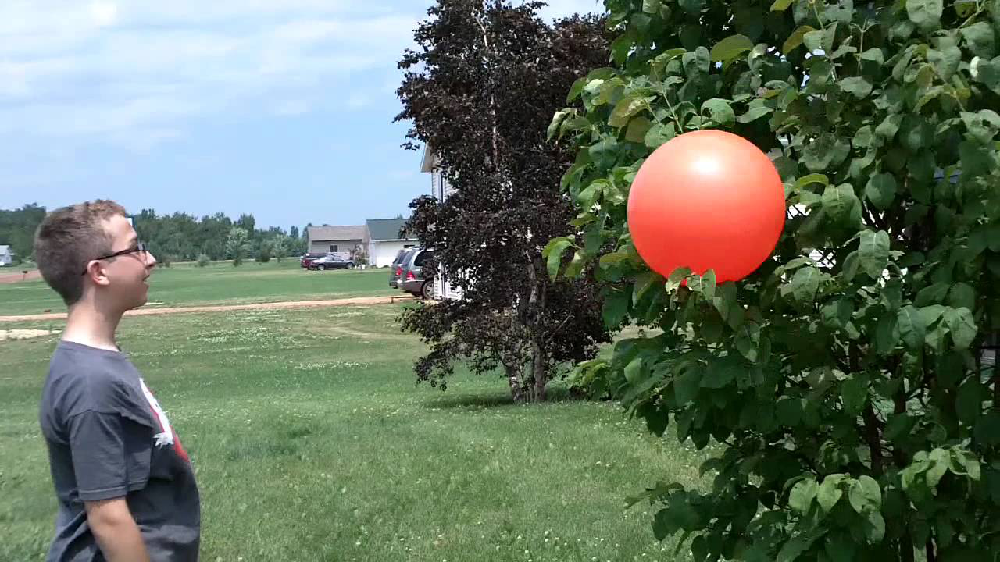

In [2]:
im = Image.open('ball.jpeg')
display(im)

## Cropping

Sometimes, we only require to do basic manipulations to our image. The most common of these is cropping. For example, we might want to try cropping the ball.

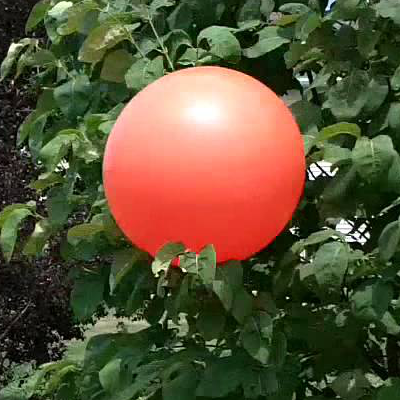

In [3]:
# box = (left, upper, right, lower)

box = (700, 100, 1100, 500)
ball = im.crop(box)

display(ball)

## Rotations and Scalings

Once we have our cropped image, we sometimes want to apply transformations to it to generate an augmented data set of images for your training set. This is easily accomplished with PIL.

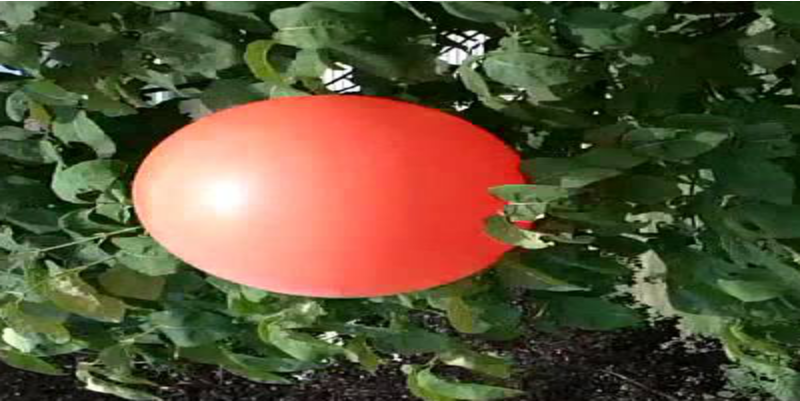

In [4]:
def scale_and_rotate_image(im, sx, sy, deg_ccw):
    im_orig = im
    im = Image.new('RGBA', im_orig.size, (255, 255, 255, 255))
    im.paste(im_orig)

    w, h = im.size
    angle = math.radians(-deg_ccw)

    cos_theta = math.cos(angle)
    sin_theta = math.sin(angle)

    scaled_w, scaled_h = w * sx, h * sy

    new_w = int(math.ceil(math.fabs(cos_theta * scaled_w) + math.fabs(sin_theta * scaled_h)))
    new_h = int(math.ceil(math.fabs(sin_theta * scaled_w) + math.fabs(cos_theta * scaled_h)))

    cx = w / 2.
    cy = h / 2.
    tx = new_w / 2.
    ty = new_h / 2.

    a = cos_theta / sx
    b = sin_theta / sx
    c = cx - tx * a - ty * b
    d = -sin_theta / sy
    e = cos_theta / sy
    f = cy - tx * d - ty * e

    return im.transform(
        (new_w, new_h),
        Image.AFFINE,
        (a, b, c, d, e, f),
        resample=Image.BILINEAR
    )


rotated_ball = scale_and_rotate_image(ball, 1.0, 2.0, 90)
display(rotated_ball)

## Color Channels

Computers don't "see" images the same way we do. As we are taught in school, the primary colors are red, yellow, and blue and these colors can make all other colors. We have chosen to represent colors to computers in a similar way. We often represent every color as a combination of 3 or 4 channels. The most common is RGBA:

- R: red
- G: green
- B: blue
- A: alpha (transparency)

Can we use this to automate the search of the ball?

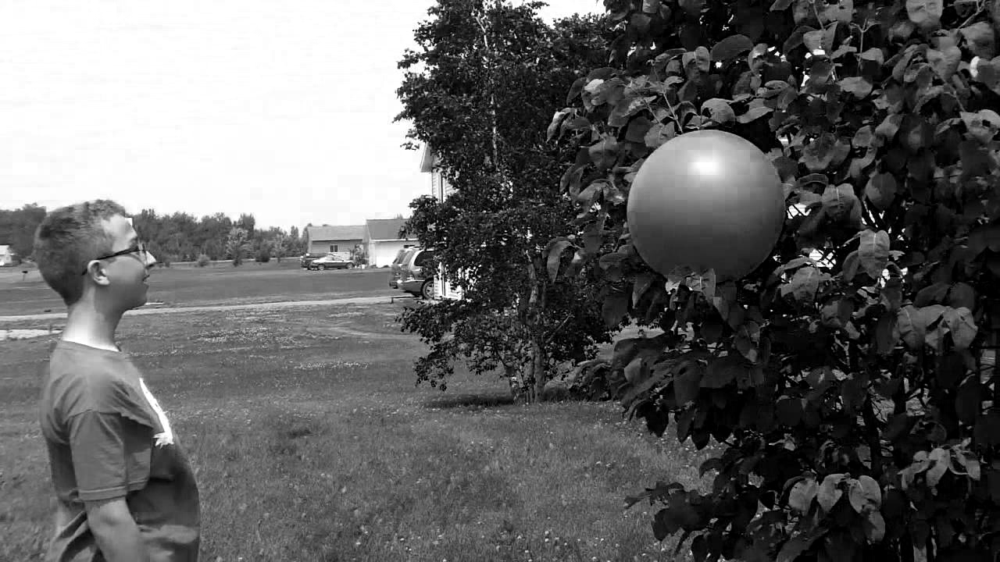

In [5]:
r, g, b = im.split()

display(b)

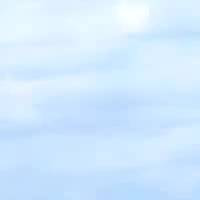

In [6]:
def find_largest_patch(im, patch_w, patch_h):

    w, h = im.size
    arr = np.zeros((w, h))
    
    thresh = 200
    
    for i in range(w):
        for j in range(h):
            if im.getpixel((i, j)) > thresh:
                arr[i, j] = 1
                
    # brute force very slow!!!
    largest = 0
    indices = (0, 0)
    
    for i in range(w-patch_w):
        for j in range(h-patch_h):
            if arr[i:i+patch_w, j:j+patch_h].sum() > largest:
                largest = arr[i:i+patch_w, j:j+patch_h].sum()
                indices = (i, j)
    
                
    return indices[0], indices[1], patch_w, patch_h

i, j, w, h = find_largest_patch(b, 200, 200)

box = (i, j, i+w, j+h)
ball = im.crop(box)

display(ball)

## Other Channels

AS mentioned, RGB is the most common channel and is conducive to finding very bright colors that contain a lot of one of the primary colors (like an orange ball has a lot of red). But what if we want to isolate an something that has a fairly "mixed" color such as the barn in this example.

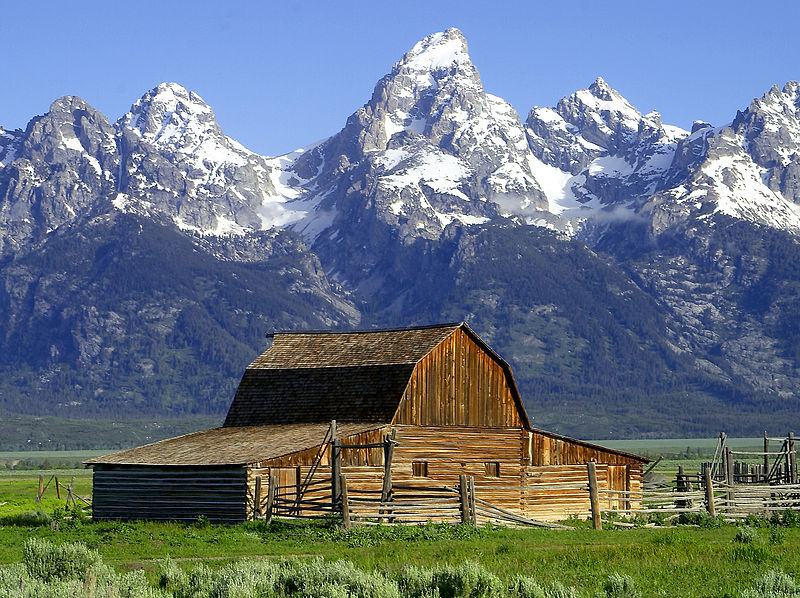

In [7]:
im = Image.open('grand_tetons.jpg')
display(im)

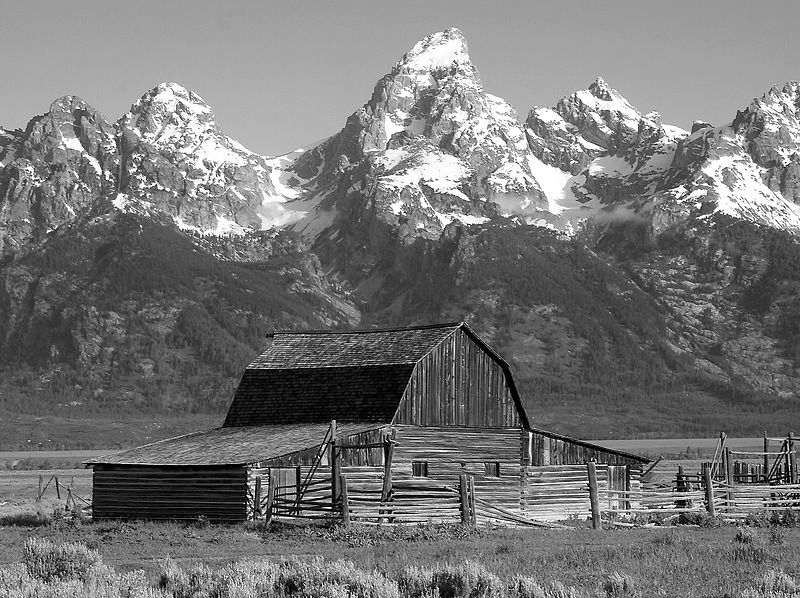

In [8]:
r, g, b = im.split()

display(g)

As I mentioned earlier, computers don't "see" color and so they are not restricted to thinking of the primary colors. They can change their "base" colors to something else. For example, in printing, they use CMYK

- C: Cyan
- M: Magenta
- Y: Yellow
- K: Key - the black in the image

We can use these different systems to help our algorithms detect features in our images.

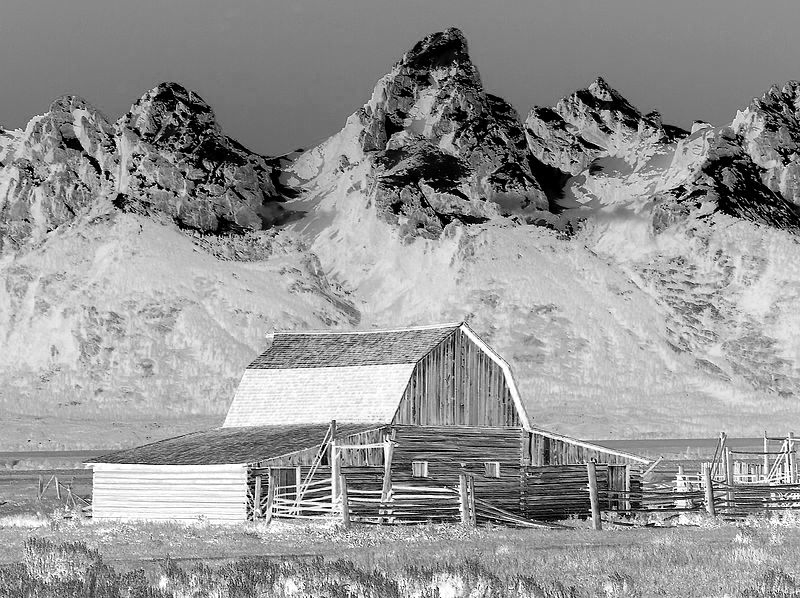

In [9]:
im = im.convert('CMYK')

c, m, y, k = im.split()

display(c)

In this case, CMYK doesn't help use very much, but we can do some fun stuff like make the magenta channel more intense and see the effect. We can use the `.point()` method which is similar to Pandas' `apply()` function.

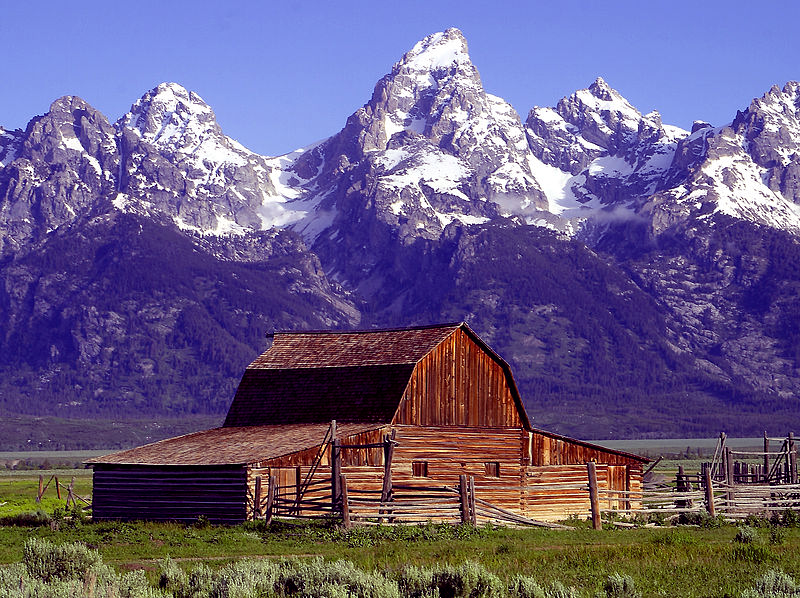

In [10]:
m = m.point(lambda i: i * 1.2)
new_im = Image.merge('CMYK', (c,m,y,k)).convert('RGB')

display(new_im)

Of course, there is the grayscale mode for images which is 'L' but the last one I want to talk about is HSV

- H: Hue
- S: Saturation
- V: Value

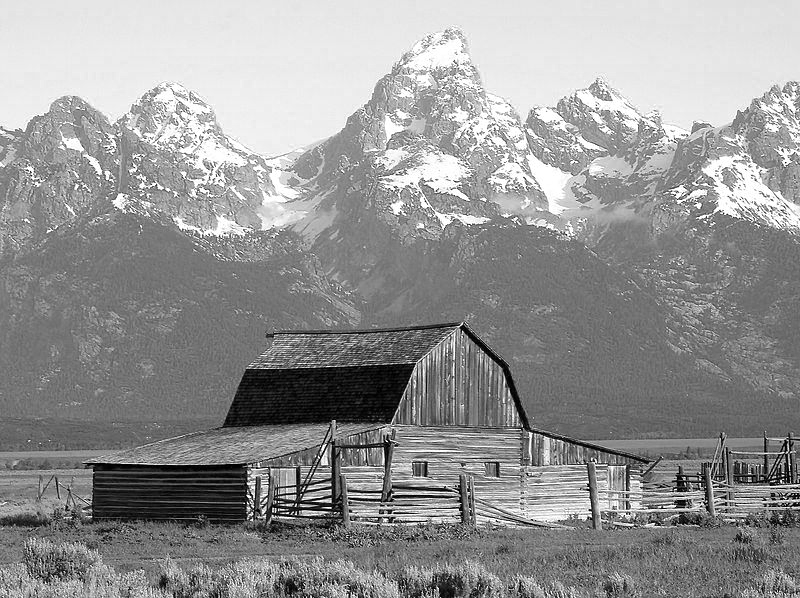

In [11]:
im = Image.open('grand_tetons.jpg')
im = im.convert('HSV')

h, s, v = im.split()

display(v)

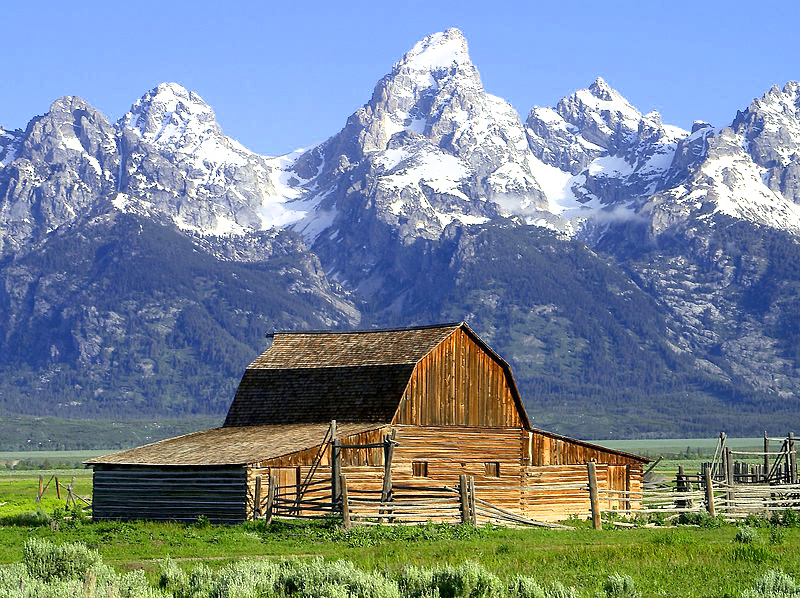

In [12]:
v = v.point(lambda i: i * 1.2)
new_im = Image.merge('HSV', (h,s,v)).convert('RGB')

display(new_im)

## Enhancements & Filters

The last common thing done to images is to apply filters. You are familiar with these because of Instagram. In PIL, there are a couple of built in filters one can use. Here are the most common.

### Edge Finding

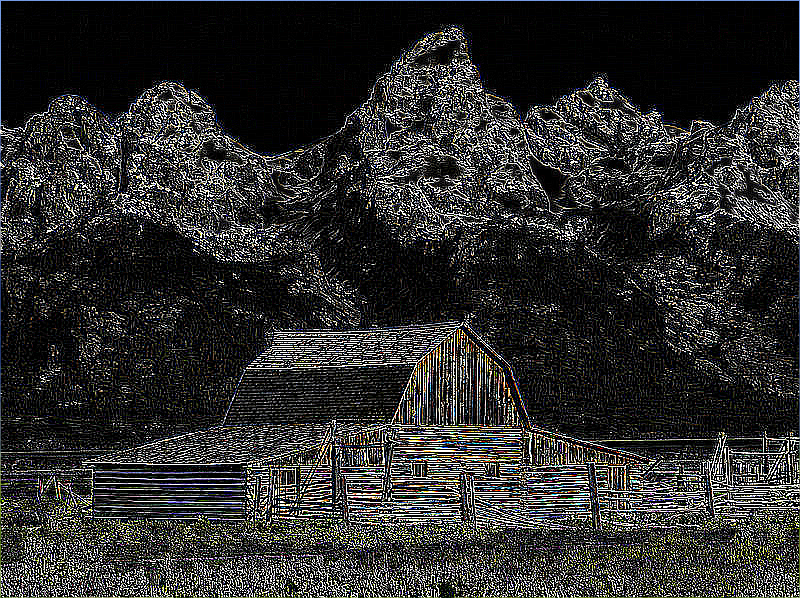

In [13]:
im = Image.open('grand_tetons.jpg')
out = im.filter(ImageFilter.FIND_EDGES)

display(out)

### Enhance (like the movies, but not really)

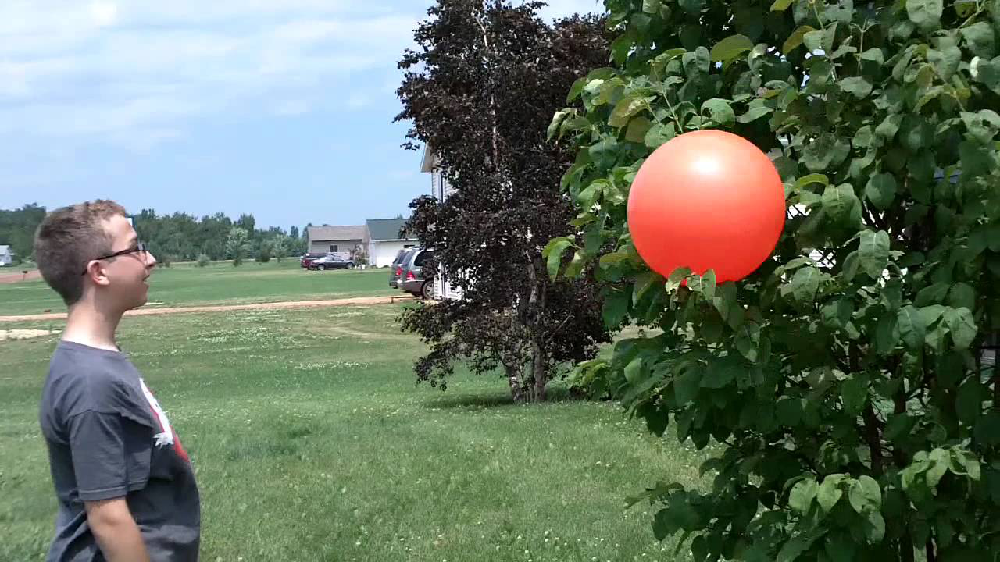

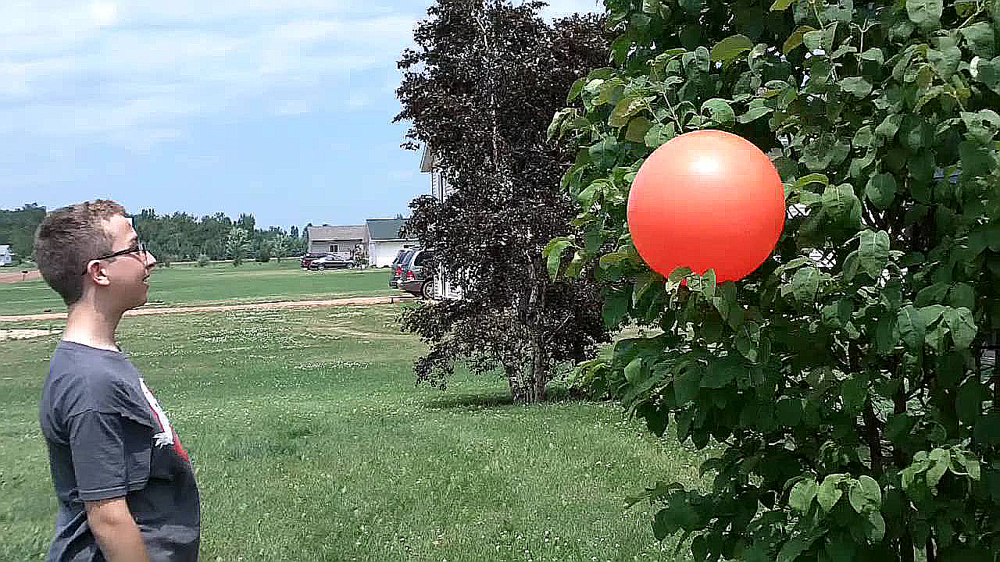

In [14]:
im = Image.open('ball.jpeg')
display(im)

out = im.filter(ImageFilter.EDGE_ENHANCE)
display(out)

We can even apply our own filters if we know how to build them. This is done using kernels.

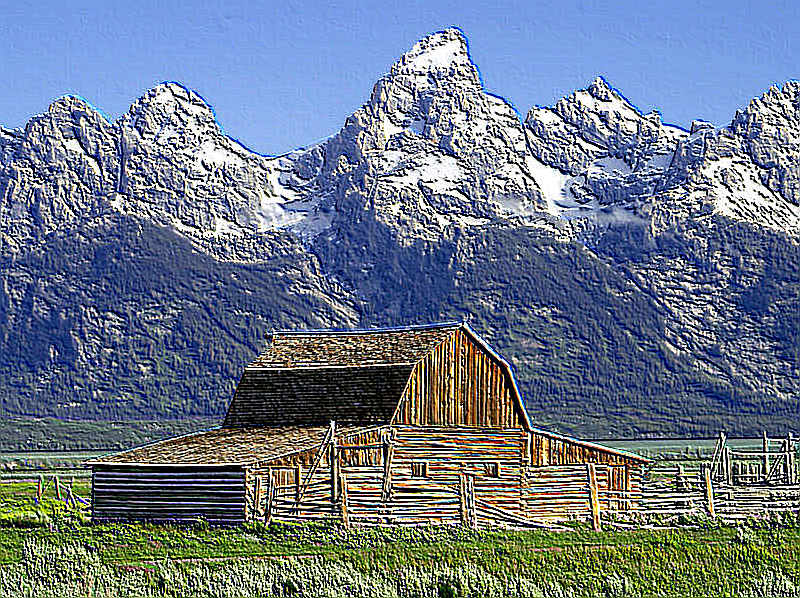

In [15]:
im = Image.open('grand_tetons.jpg')

km = (
     -2, -1,  0,
     -1,  1,  1,
      0,  1,  2
)

# edge kernel

edge_km = (
    -1, -1, -1,
    -1, 8, -1,
    -1, -1, -1
)

scale = 1 if abs(sum(km)) == 0 else abs(sum(km))

k = ImageFilter.Kernel(
    size=(3, 3),
    kernel=km,
    scale=scale,
    offset=0
)

out = im.filter(k)

display(out)

The last filter I want to talk about is the mode filter. It simply grabs the model value pixel in every NxN box in the image. This can compress images and remove noise.

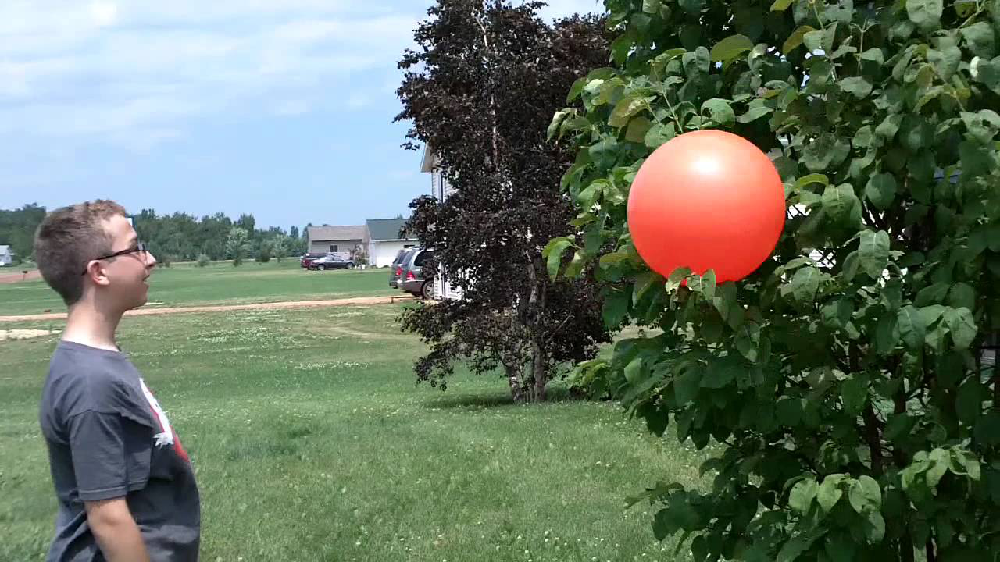

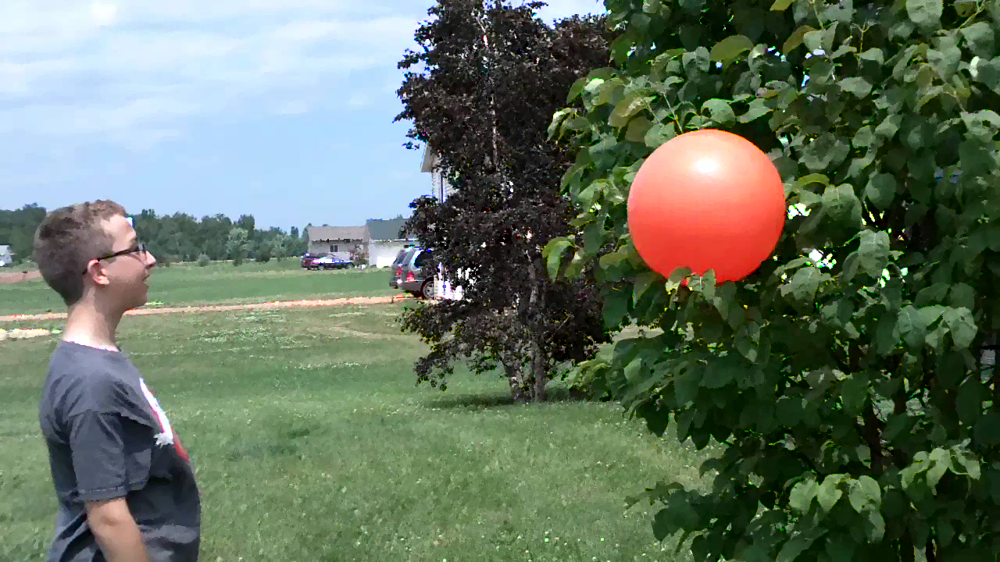

In [16]:
im = Image.open('ball.jpeg')
display(im)

out = im.filter(ImageFilter.ModeFilter(5))
display(out)

The last thing I want to mention is that a lot of image preprocessing is done for the purpose of data augmentation. That is, we only have 100 images and we want to give our training algorithm many more images so that the model is better trained. We can rotate, crop, and stretch images to generate a lot of images. But like I keep mentioning, computers don't see color. To them, a white pixel (0,0,0) and a black pixel (255,255,255) is just as different as a blue (0,0,255) and slightly blue (0,0,125) pixel. Thus, sometimes we want to augment our images with random noise so that the algorithm can learn that minor variations in the pixels don't matter. To do this, we often apply noise to the image.

### Gaussian Noise

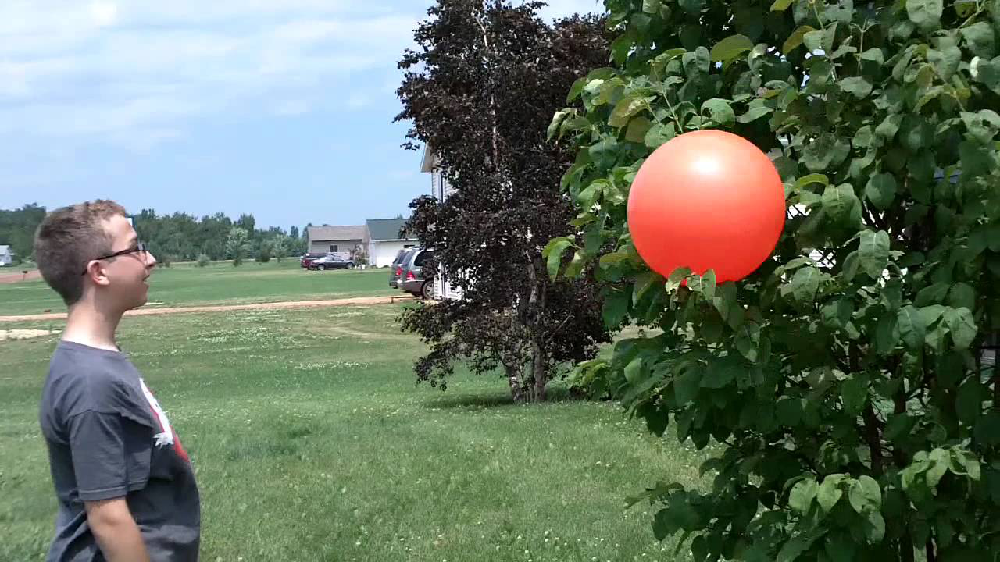

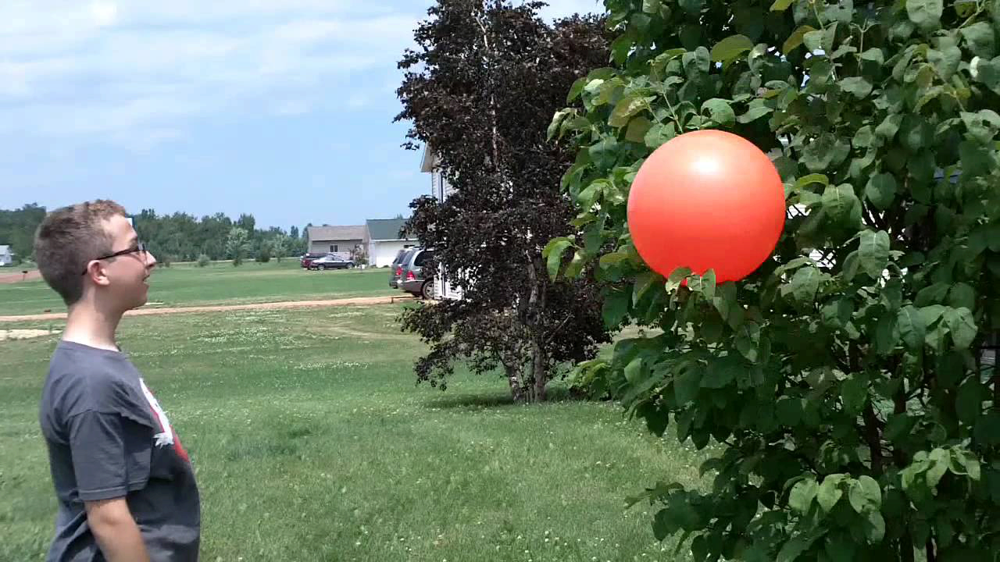

In [17]:
im = Image.open('ball.jpeg')
display(im)

out = im.point(lambda i: i + np.random.normal(0,1))
display(out)

These images look identical to us but are very "far" apart to the computer.